In [ ]:
import numpy as np
import pandas as pd
from catboost import CatBoostRegressor
import pymongo
import plotly.graph_objects as go
from sklearn.model_selection import train_test_split
from box import Box
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.metrics import davies_bouldin_score
from datetime import datetime 
from scipy.stats import skew, kurtosis
import pickle
import os
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import tensorflow
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Input, LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping

In [2]:
# C:\Users\AL49\.pyenv\pyenv-win\versions\3.12.4\python.exe -m pip install package

In [3]:
def create_sequences(x: np.ndarray, seqlen: int) -> np.ndarray:
    '''
    Create sequential data array of a given sequence length for a 1D array.

    Arguments:
    x (np.ndarray): 1D array sorted chronologically.
    seqlen (int): Sequence length.

    Returns:
    x_sequences (np.ndarray): 2D array. If x has length N, x_sequences has shape (N-seqlen+1, seqlen)
    '''

    n_sequences = len(x) - seqlen + 1

    x_tiled = np.tile(x.reshape(-1,1), reps=n_sequences).T

    rows = np.arange(n_sequences).reshape(-1,1)
    cols = np.arange(seqlen) + np.arange(n_sequences).reshape(-1,1)

    x_sequences = x_tiled[rows, cols]

    return x_sequences

# Import Data

In [4]:
df = pd.read_pickle(r"C:\Users\hobly\OneDrive\2_EverythingElse\CV\Ceto\feb20\vessel.pkl")

# Exploratory Data Analysis

In [5]:
df['recordedAt'].describe()

count                            59010
mean     2023-05-30 12:00:22.950686464
min                2023-05-10 00:00:00
25%                2023-05-20 05:48:00
50%                2023-05-30 12:00:00
75%                2023-06-09 18:12:00
max                2023-06-20 00:00:00
Name: recordedAt, dtype: object

In [6]:
df['recordedAt'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 59010 entries, 0 to 59009
Series name: recordedAt
Non-Null Count  Dtype         
--------------  -----         
59010 non-null  datetime64[ns]
dtypes: datetime64[ns](1)
memory usage: 461.1 KB


In [7]:
df['value'].describe()

count    59010.000000
mean       163.491527
std        152.178146
min         29.000000
25%         47.000000
50%         51.000000
75%        363.000000
max        414.000000
Name: value, dtype: float64

In [8]:
df['value'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 59010 entries, 0 to 59009
Series name: value
Non-Null Count  Dtype
--------------  -----
59010 non-null  int64
dtypes: int64(1)
memory usage: 461.1 KB


There are no NULL entries

In [9]:
# extract logConfig_id and vessel_id from the metadata
df['logConfig_id'] = df['metadata'].apply(lambda d: d['logConfig_id'])
df['vessel_id'] = df['metadata'].apply(lambda d: d['vessel_id'])

# sort by time
df = df.sort_values(by='recordedAt').reset_index(drop=True)

print('Unique logConfig_id: ', df['logConfig_id'].unique().size)
print('Unique vessel_id: ', df['vessel_id'].unique().size)
df.head()

Unique logConfig_id:  6
Unique vessel_id:  1


,recordedAt,metadata,value,_id,logConfig_id,vessel_id
0,2023-05-10,"{'logConfig_id': 65aa8bf3e7fd0af02f490013, 've...",49,67055816dd530b3e2cae60ac,65aa8bf3e7fd0af02f490013,659c47376b1b1330ce49df91
1,2023-05-10,"{'logConfig_id': 65aa8bf3e7fd0af02f49001a, 've...",46,67055816dd530b3e2cae60a2,65aa8bf3e7fd0af02f49001a,659c47376b1b1330ce49df91
2,2023-05-10,"{'logConfig_id': 65aa8bf3e7fd0af02f48ffe7, 've...",48,67055816dd530b3e2cae60b6,65aa8bf3e7fd0af02f48ffe7,659c47376b1b1330ce49df91
3,2023-05-10,"{'logConfig_id': 65aa8bf3e7fd0af02f48ffd4, 've...",47,67055816dd530b3e2cae608e,65aa8bf3e7fd0af02f48ffd4,659c47376b1b1330ce49df91
4,2023-05-10,"{'logConfig_id': 65aa8bf3e7fd0af02f490040, 've...",46,67055816dd530b3e2cae60c0,65aa8bf3e7fd0af02f490040,659c47376b1b1330ce49df91


In [10]:
# split the sensor signals into separate DataFrames
signals = []
config_ids = df['logConfig_id'].unique().tolist()

for id in config_ids:
    df_mini = df[df['logConfig_id']==id]
    signals.append(df_mini)
    print(len(df_mini))

9835
9835
9835
9835
9835
9835


each sensor has the same number of data points

In [11]:
# check if the time column for all sensors are the same
recordedAt_equal = []
df_prev = signals[0]
for df_signal in signals[1:]:
    is_equal = np.all(df_signal['recordedAt'].values == df_prev['recordedAt'].values)
    print(is_equal)
    recordedAt_equal.append(is_equal)

print('Time column equal: ', np.all(recordedAt_equal))

True
True
True
True
True
Time column equal:  True


Each sensor has the same time column

In [12]:
# check if time has constant time step or if it has jumps 
time_col = signals[0]['recordedAt']
dt = time_col.diff().dropna()

dt.value_counts()

recordedAt
0 days 00:06:00    9831
0 days 00:18:00       1
0 days 00:12:00       1
0 days 00:24:00       1
Name: count, dtype: int64

the time step is not constant

In [13]:
time_steps = dt.apply(lambda timedelt: timedelt.total_seconds()/dt.mode()[0].total_seconds())

time_steps.value_counts()

recordedAt
1.0    9831
3.0       1
2.0       1
4.0       1
Name: count, dtype: int64

There are time skips, but only on the scale of 4 time steps

In [14]:
# since all the time columns are equal, all the signals can be put into 1 table

# convert time into something model can handle

df_sep = pd.DataFrame({'recordedAt': signals[0]['recordedAt'].values})
signal_names = []

for i, df_signal in enumerate(signals):
    sn = f'sensor_{i}'
    signal_names.append(sn)
    df_sep[sn] = df_signal['value'].values.copy()

df_sep

,recordedAt,sensor_0,sensor_1,sensor_2,sensor_3,sensor_4,sensor_5
0,2023-05-10 00:00:00,49,46,48,47,46,47
1,2023-05-10 00:06:00,48,46,48,47,46,47
2,2023-05-10 00:12:00,48,47,48,47,47,47
3,2023-05-10 00:18:00,49,47,48,47,46,47
4,2023-05-10 00:24:00,48,46,48,47,46,47
...,...,...,...,...,...,...,...
9830,2023-06-19 23:36:00,380,389,394,382,408,394
9831,2023-06-19 23:42:00,379,391,397,381,408,390
9832,2023-06-19 23:48:00,379,392,397,381,408,391
9833,2023-06-19 23:54:00,379,395,396,380,408,390


In [16]:
signal_names

['sensor_0', 'sensor_1', 'sensor_2', 'sensor_3', 'sensor_4', 'sensor_5']

# Data Cleaning

There is are missing values in columns but there are missing time-steps. These make up a very small number of steps - 3 occurrences, max 4 steps in a row.

In [16]:
# fill in the missing time steps using interpolation

dt = df_sep['recordedAt'].diff().mode()[0]
print('dt mode:', dt)
time_col = np.arange(start=df_sep['recordedAt'].iloc[0], stop=df_sep['recordedAt'].iloc[-1], step=dt)

df_cts = pd.DataFrame({'recordedAt': time_col}) #constant time step

df_cleaned = pd.merge(df_cts, df_sep, on='recordedAt', how='left')
print('\nisna')
print(df_cleaned.isna().sum())

print('\nisna')
df_cleaned = df_cleaned.interpolate()
print(df_cleaned.isna().sum())

df_cleaned

dt mode: 0 days 00:06:00

isna
recordedAt    0
sensor_0      6
sensor_1      6
sensor_2      6
sensor_3      6
sensor_4      6
sensor_5      6
dtype: int64

isna
recordedAt    0
sensor_0      0
sensor_1      0
sensor_2      0
sensor_3      0
sensor_4      0
sensor_5      0
dtype: int64


,recordedAt,sensor_0,sensor_1,sensor_2,sensor_3,sensor_4,sensor_5
0,2023-05-10 00:00:00,49.0,46.0,48.0,47.0,46.0,47.0
1,2023-05-10 00:06:00,48.0,46.0,48.0,47.0,46.0,47.0
2,2023-05-10 00:12:00,48.0,47.0,48.0,47.0,47.0,47.0
3,2023-05-10 00:18:00,49.0,47.0,48.0,47.0,46.0,47.0
4,2023-05-10 00:24:00,48.0,46.0,48.0,47.0,46.0,47.0
...,...,...,...,...,...,...,...
9835,2023-06-19 23:30:00,380.0,387.0,396.0,381.0,407.0,393.0
9836,2023-06-19 23:36:00,380.0,389.0,394.0,382.0,408.0,394.0
9837,2023-06-19 23:42:00,379.0,391.0,397.0,381.0,408.0,390.0
9838,2023-06-19 23:48:00,379.0,392.0,397.0,381.0,408.0,391.0


# Feature Engineering

In [17]:
df_fe = df_cleaned.copy()

In [18]:
# visualise the time series

fig = go.Figure()
for i, sn in enumerate(signal_names):
    fig.add_trace(go.Scatter(x=df_fe['recordedAt'],y=df_sep[sn], mode='lines', name=sn))
fig.add_trace(go.Scatter(x=df_fe['recordedAt'],y=df_sep[signal_names].mean(axis=1), mode='lines', name='mean'))
fig.update_layout(title='Signals vs Time')
fig.show()

fig = go.Figure()
for i, sn in enumerate(signal_names):
    fig.add_trace(go.Scatter(x=df_fe.index,y=df_sep[sn], mode='lines', name=sn))
fig.add_trace(go.Scatter(x=df_fe.index,y=df_sep[signal_names].mean(axis=1), mode='lines', name='mean'))
fig.update_layout(title='Signals vs Index')
fig.show()

* sensors appear to be measuring the same or similar source signal, and anomalies can be characterised by deviations between sensors
* the signal seems to jump between a high and low state, but also appears to be drifting upwards
* Engineering a stationary feature will help to identify fluctuations that aren't simply the signal increasing/decreasing as normal

In [19]:
# try scaling values at each time step to be between 0 and 1, scaled relative to each other at that moment in time - as a method of making the data stationary 

df_fe['max_val'] = df_fe[signal_names].max(axis=1)
df_fe['min_val'] = df_fe[signal_names].min(axis=1)
df_fe['max-min'] = df_fe['max_val']-df_fe['min_val']
df_fe['mean'] = df_fe[signal_names].mean(axis=1)

In [20]:
for sn in signal_names:
    df_fe[f'{sn}_relative'] = df_fe.apply(lambda row: (row[sn]-row['min_val'])/max(1,row['max-min']), axis=1)
    df_fe[f'{sn}-mean'] = df_fe[sn]-df_fe['mean']
    df_fe[f'({sn}-mean)/mean'] = df_fe[f'{sn}-mean']/df_fe['mean']

In [21]:
fig = go.Figure()
for sn in signal_names:
    fig.add_trace(go.Scatter(x=df_fe['recordedAt'],y=df_fe[f'{sn}_relative'], mode='lines'))
fig.update_layout(title='(signal - min<sub>t</sub>)/(max<sub>t</sub> - min<sub>t</sub>)')
fig.show()

In [22]:
# above feature looks erratic, doesn't capture the source signal well

# make a stationary feature by deducing by the instantaneous average between sensors

fig = go.Figure()
for sn in signal_names:
    fig.add_trace(go.Scatter(x=df_fe['recordedAt'],y=df_fe[f'{sn}-mean'], mode='lines'))
fig.update_layout(title='signal - mean<sub>t</sub>')
fig.show()

In [23]:
# above, the feature's magnitude is large when the source signal is large, but the relative fluctuation may be about the same
# create a new feature by both subtracting and dividing by the instantaneous mean between sensors 

fig = go.Figure()
for sn in signal_names:
    fig.add_trace(go.Scatter(x=df_fe['recordedAt'],y=df_fe[f'({sn}-mean)/mean'], mode='lines'))
fig.update_layout(title='(signal - mean<sub>t</sub>)/mean<sub>t</sub>')
fig.show()

In [24]:
# Above: Large instantaneous spikes where there is a spike in the original time signal. These will be captured as anomalies by most anomaly schemes.

# Apply differencing to if the spikes in the engineered feature coincide with spikes in delta-signal

for sn in signal_names:
    df_fe[f'{sn}-diff'] = df_fe[sn].diff().fillna(0)

df_fe['mean_diff'] = df_fe[[f'{sn}-diff' for sn in signal_names]].mean(axis=1)

fig = go.Figure()
for i, sn in enumerate(signal_names):
    fig.add_trace(go.Scatter(x=df_fe['recordedAt'],y=df_fe[f'{sn}-diff'], mode='lines', name=f'{sn}-diff'))
fig.add_trace(go.Scatter(x=df_fe['recordedAt'],y=df_fe['mean_diff'], mode='lines', name='mean_diff'))
fig.update_layout(title=u'\u0394signal')
fig.show()

In [25]:
# The above large changes are a normal part of the signal

In [26]:
# divide by the differenced value so that the feature's magnitude is reduced ONLY where there is a large change in the source signal 

fig = go.Figure()

for sn in signal_names:

    col = f'({sn}-mean)/mean'

    new_feature = df_fe[col]/(df_fe['mean_diff'].abs()+1)

    df_fe[f'{sn}-scaled'] = new_feature

    fig.add_trace(go.Scatter(x=df_fe['recordedAt'],y=new_feature, name=sn))
fig.update_layout(title=u'((signal - mean<sub>t</sub>)/mean<sub>t</sub>)/(|\u0394signal|+1)')
fig.show()

In [27]:
df_fe

,recordedAt,sensor_0,sensor_1,sensor_2,sensor_3,sensor_4,sensor_5,max_val,min_val,max-min,...,sensor_3-diff,sensor_4-diff,sensor_5-diff,mean_diff,sensor_0-scaled,sensor_1-scaled,sensor_2-scaled,sensor_3-scaled,sensor_4-scaled,sensor_5-scaled
0,2023-05-10 00:00:00,49.0,46.0,48.0,47.0,46.0,47.0,49.0,46.0,3.0,...,0.0,0.0,0.0,0.000000,0.038869,-0.024735,0.017668,-0.003534,-0.024735,-0.003534
1,2023-05-10 00:06:00,48.0,46.0,48.0,47.0,46.0,47.0,48.0,46.0,2.0,...,0.0,0.0,0.0,-0.166667,0.018237,-0.018237,0.018237,0.000000,-0.018237,0.000000
2,2023-05-10 00:12:00,48.0,47.0,48.0,47.0,47.0,47.0,48.0,47.0,1.0,...,0.0,1.0,0.0,0.333333,0.010563,-0.005282,0.010563,-0.005282,-0.005282,-0.005282
3,2023-05-10 00:18:00,49.0,47.0,48.0,47.0,46.0,47.0,49.0,46.0,3.0,...,0.0,-1.0,0.0,0.000000,0.035211,-0.007042,0.014085,-0.007042,-0.028169,-0.007042
4,2023-05-10 00:24:00,48.0,46.0,48.0,47.0,46.0,47.0,48.0,46.0,2.0,...,0.0,0.0,0.0,-0.333333,0.015957,-0.015957,0.015957,0.000000,-0.015957,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9835,2023-06-19 23:30:00,380.0,387.0,396.0,381.0,407.0,393.0,407.0,380.0,27.0,...,-1.0,1.0,-1.0,0.333333,-0.020478,-0.007039,0.010239,-0.018558,0.031357,0.004480
9836,2023-06-19 23:36:00,380.0,389.0,394.0,382.0,408.0,394.0,408.0,380.0,28.0,...,1.0,1.0,1.0,0.500000,-0.019031,-0.003693,0.004829,-0.015623,0.028689,0.004829
9837,2023-06-19 23:42:00,379.0,391.0,397.0,381.0,408.0,390.0,408.0,379.0,29.0,...,-1.0,0.0,-4.0,-0.166667,-0.026306,0.000000,0.013153,-0.021922,0.037267,-0.002192
9838,2023-06-19 23:48:00,379.0,392.0,397.0,381.0,408.0,391.0,408.0,379.0,29.0,...,0.0,0.0,1.0,0.333333,-0.023637,0.001278,0.010860,-0.019804,0.031942,-0.000639


# Train-Test Split

- Extract non-anomalous data, split that into train and test
- The rest is a mix of anomalies and non-anomalous

In [28]:
fig = go.Figure()
for sn in signal_names:
    fig.add_trace(go.Scatter(x=df_fe.index,y=df_fe[f'{sn}-scaled'], name=sn))
fig.update_layout(title='Feature vs Index')
fig.show()

In [29]:
# the first 2000 steps, and last ~2000 steps are considered as normal operation 

non_anomalous_idxs = list(range(0,2000))+list(range(8000,len(df_fe)))
unknown_idxs = [i for i in range(len(df_fe)) if i not in non_anomalous_idxs]

In [30]:
df_unknown = df_fe.loc[unknown_idxs]

In [31]:
feature_names = [f'{sn}-scaled' for sn in signal_names]
label_names = feature_names

In [32]:
# organise the data into a dictionary-like object for ease of use 

data_box = Box({'non_anomalous':{'train':{},'test':{}},'unknown':{}})

In [33]:
data_box['non_anomalous']['train']['df'], data_box['non_anomalous']['test']['df'] = train_test_split(df_fe.loc[non_anomalous_idxs], test_size=0.3, random_state=42)

In [34]:
data_box['unknown'] = df_fe.loc[unknown_idxs]

# Modelling

Modelling approach: to capture deviations between sensors, a regression model will be used to model the relationship between the 6 sensors. Input is the engineered feature from the 5 other sensors, and the output is the prediction of the sensor left out.

CatBoost was used as it is a powerful regressor that trains very quickly, and works out of the box without requiring any hyperparameter tuning.

In [35]:
# don't retrain if re-running the notebook and there's already a model trained
if 'models.pkl' not in os.listdir():
    models = []

    for i in range(len(feature_names)):
        idxs = [j for j in range(len(feature_names)) if j != i]
        model_i = model = CatBoostRegressor()
        model_i.fit(
            X=data_box["non_anomalous"]["train"]["df"][feature_names].values[:, idxs],
            y=data_box["non_anomalous"]["train"]["df"][label_names].values[:, i],
            eval_set=(
                data_box["non_anomalous"]["test"]["df"][feature_names].values[:, idxs],
                data_box["non_anomalous"]["test"]["df"][label_names].values[:, i],
            ),
            early_stopping_rounds=100,
        )
        models.append(model_i)


    with open('models.pkl', 'wb') as file:
        pickle.dump(models, file)
else:
    with open('models.pkl', 'rb') as file:
        models = pickle.load(file)

Sequential auto-encoder can be used to detect anomalies in time, rather than wrt relative sensors

In [36]:
# The 6 sensors are correlated, so we can use dimension reduction to create a more manageable NN

sequential_features = signal_names
pca = PCA(n_components=1)
y_pc = pca.fit_transform(df_fe[sequential_features]).squeeze()

fig = go.Figure(go.Scatter(y=y_pc,name='pc'))
fig = fig.add_trace(go.Scatter(y=df_fe['mean'], name='mean', line=dict(dash='dash'), yaxis='y2'))
fig.update_layout(title='Principal Component', yaxis2=dict(overlaying="y", side="right"))
fig.show()

The PCA signal is exactly the same as the mean between the 6 sensors, so the mean will be used as the input signal to the autoencoder

In [37]:
# define a helper function to help with defining the indices of distinct time periods

def extract_list_of_ranges(list_of_ranges) -> list:
    '''
    Given a list of range generators, returns a list of the integers generated
    '''

    list_of_integers = []
    for rng in list_of_ranges:
        list_of_integers += list(rng)

    return list_of_integers

In [38]:
# a sequence length of 100 was chosen as this period will entirely capture transient events such as dips, which were observed in the data by eye

seqlen = 100

print(f"Sequence length: {seqlen * 6} minutes")

# sections for training used to capture non-anomalous periods
training_idxs_seq = [
    range(2000),
    range(5100, 5398),
    range(5700, 6020),
    range(8000, len(df_fe)),
]

# the testing sections is the remaining time periods
testing_idxs_seq = [
    range(2000, 5100), 
    range(5398, 5700), 
    range(6020, 8000)
]

# create sequences from the time periods
# separate calls of create_sequences prevents 1 sequence from containing 2 distinct time periods
x_train_sequential = np.vstack(
    [
        create_sequences(df_fe.loc[list(rng), sequential_features].values, seqlen)
        for rng in training_idxs_seq
    ]
)

# performance on descents was observed to be poor
# augment the training dataset with more descents, with noise added to mitigate overfitting
repeated_indices = range(5187, 5394)
seq_to_repeat = create_sequences(df_fe.loc[list(repeated_indices), sequential_features].values, seqlen)
n_repeats = 6
for n in range(n_repeats):
    noise = np.random.uniform(low=0.98, high=1.2, size=seq_to_repeat.shape)
    seq_to_insert = noise * seq_to_repeat
    x_train_sequential = np.vstack((x_train_sequential,seq_to_insert))

x_test_sequential = np.vstack(
    [
        create_sequences(df_fe.loc[list(rng), sequential_features].values, seqlen)
        for rng in testing_idxs_seq
    ]
)

# scale the arrays
# neural networks require scaled data, unlike CatBoost 
x_max = x_train_sequential.max()
x_min = x_train_sequential.min()
x_ran = x_max - x_min

x_train_sequential = (x_train_sequential - x_min) / x_ran
x_test_sequential = (x_test_sequential - x_min) / x_ran

if 'model_autoenc.keras' not in os.listdir():
    model_autoenc = Sequential()
    model_autoenc.add(Input((seqlen, 1)))
    model_autoenc.add(LSTM(64, return_sequences=True))
    model_autoenc.add(Dropout(0.5))
    model_autoenc.add(LSTM(32, return_sequences=True))
    model_autoenc.add(Dropout(0.5))
    model_autoenc.add(LSTM(64, return_sequences=True))
    model_autoenc.add(Dropout(0.5))
    model_autoenc.add(Dense(1))
    model_autoenc.compile(optimizer="adam", loss="mse")
    history_autoenc = model_autoenc.fit(
        x_train_sequential,
        x_train_sequential,
        epochs=500,
        batch_size=32,
        validation_data=(x_test_sequential, x_test_sequential),
        callbacks=EarlyStopping(monitor="val_loss", patience=20, restore_best_weights=True),
    ).history
    model_autoenc.save('model_autoenc.keras')
    with open('history_autoenc.pkl', 'wb') as file:
        pickle.dump(history_autoenc, file)
else:
    model_autoenc = load_model('model_autoenc.keras')
    with open('history_autoenc.pkl', 'rb') as file:
        history_autoenc = pickle.load(file)


Sequence length: 600 minutes


## Evaluation

In [39]:
# Losses for the CatBoost models

fig = go.Figure()
for i in range(6):
    history = models[i].get_evals_result()
    fig.add_trace(go.Scatter(y=history['learn']['RMSE'],name=f'train-{i}', line=dict(color='blue')))
    fig.add_trace(go.Scatter(y=history['validation']['RMSE'],name=f'test-{i}', line=dict(color='red')))
fig.update_layout(
    title='CatBoost Training Losses',
    xaxis_title='iteration',
    yaxis_title='RMSE'
)
fig.show()

In [40]:
# visualise CatBoost predictions on the training set

df_oi = df_fe.loc[non_anomalous_idxs]

fig = go.Figure()
for i, ln in enumerate(label_names):

    model_i = models[i]
    idxs = [j for j in range(len(feature_names)) if j != i]

    pred = model_i.predict(df_oi[feature_names].values[:,idxs])
    
    fig.add_trace(go.Scatter(x=df_oi.index, y=df_oi[ln], mode='lines',name=f'true-{sn}'))
    fig.add_trace(go.Scatter(x=df_oi.index, y=pred,name=f'pred-{sn}'))

fig.show()

In [41]:
# visualise predictions on the "unknown" set

unknown_pred = np.zeros((len(df_unknown),6))

fig = go.Figure()
for i, ln in enumerate(label_names):

    model_i = models[i]
    idxs = [j for j in range(len(feature_names)) if j != i]

    unknown_pred_i = model_i.predict(df_unknown[feature_names].values[:,idxs])
    unknown_pred[:,i] = unknown_pred_i.copy()

    fig.add_trace(go.Scatter(x=df_unknown.index, y=df_unknown[ln], mode='lines',name=f'true-{ln}'))
    fig.add_trace(go.Scatter(x=df_unknown.index, y=pred,name=f'pred-{ln}'))

fig.show()

In [42]:
# residual plots
#
test_true = data_box["non_anomalous"]["test"]["df"][label_names].values

# put all the predictions into 1 array
test_pred = np.zeros_like(test_true)
for i, ln in enumerate(label_names):
    model_i = models[i]
    idxs = [j for j in range(len(feature_names)) if j != i]
    test_pred_i = model_i.predict(data_box["non_anomalous"]["test"]["df"][feature_names].values[:,idxs])
    test_pred[:,i] = test_pred_i.copy()

residuals = (test_pred - test_true).flatten()

print("Residual Mean: ", residuals.mean())
print("Residual Skew: ", skew(residuals))
print("Residual Kurtosis: ", kurtosis(residuals))


fig1 = go.Figure(
    go.Scatter(
        x=test_true.flatten(),
        y=residuals.flatten(),
        mode="markers",
        line=dict(color="red"),
    )
)
fig1.update_layout(
    title='Residuals',
    xaxis_title='value',
    yaxis_title='predicted - true'
)
fig1.show()

fig2 = go.Figure(
    go.Histogram(
        x=residuals,
        nbinsx=100,
    )
)
fig2.update_layout(
    title='Residuals Distribution',
    xaxis_title='predicted - true',
    yaxis_title='count'
)
fig2.show()

fig3 = go.Figure(
    go.Scatter(x=test_true.flatten(), y=test_pred.flatten(), mode="markers")
)
fig3.add_trace(
    go.Scatter(
        x=np.array([test_true.min(), test_true.max()]),
        y=np.array([test_true.min(), test_true.max()]),
        mode="lines",
    )
)
fig3.update_layout(
    title='Predicted vs Actual',
    xaxis=dict(
        title='Actual',
        scaleanchor='y',
        scaleratio=1
    ),
    yaxis=dict(
        title='Predicted'
    ),
)
fig3.show()


Residual Mean:  2.3025769042063307e-06
Residual Skew:  -0.20111955015765165
Residual Kurtosis:  29.022781415672014


## Sequential Model

In [43]:
fig = go.Figure()
fig.add_trace(go.Scatter(y=history_autoenc['loss'],name='train'))
fig.add_trace(go.Scatter(y=history_autoenc['val_loss'],name='test'))
fig.update_layout(
    title='Autoencoder Training Losses',
    xaxis_title='iteration',
    yaxis_title='MSE'
)
fig.show()

159/159 ━━━━━━━━━━━━━━━━━━━━ 4s 20ms/step
Residual Mean:  -0.013761512932847279
Residual Skew:  -2.2992149024088064
Residual Kurtosis:  10.959417247774274


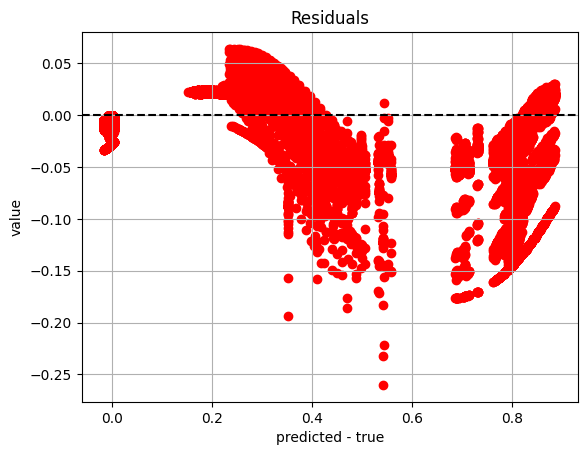

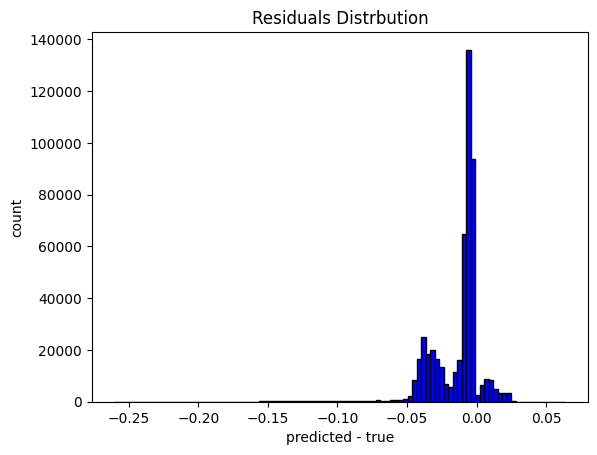

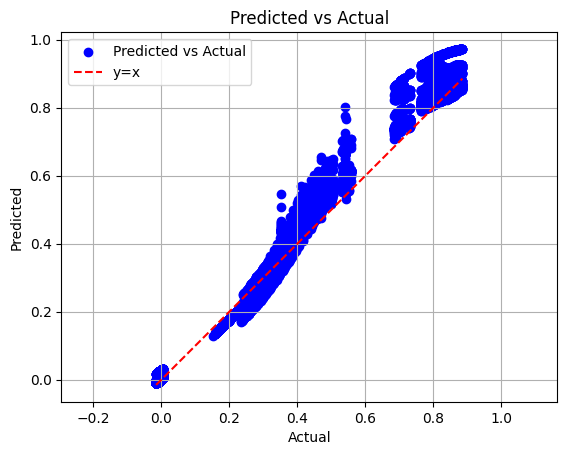

In [44]:
# residual plots

test_true_autoenc = x_test_sequential.copy().flatten()
test_pred_autoenc = model_autoenc.predict(x_test_sequential).flatten()
residuals_autoenc = (test_true_autoenc - test_pred_autoenc)

print("Residual Mean: ", residuals_autoenc.mean())
print("Residual Skew: ", skew(residuals_autoenc))
print("Residual Kurtosis: ", kurtosis(residuals_autoenc))


plt.figure()
plt.scatter(test_true_autoenc, residuals_autoenc, color='red')
plt.axhline(y=0, color='black', linestyle='--')
plt.grid(True)
plt.title('Residuals')
plt.xlabel('predicted - true')
plt.ylabel('value')
plt.show()

# Histogram of residuals
plt.figure()
plt.hist(residuals_autoenc, bins=100, color='blue', edgecolor='black')
plt.title('Residuals Distrbution')
plt.xlabel('predicted - true')
plt.ylabel('count')
plt.show()

# Scatter plot of test_true vs test_pred with a line y=x
plt.figure()
plt.scatter(test_true_autoenc, test_pred_autoenc, color='blue', label='Predicted vs Actual')
plt.plot([test_true_autoenc.min(), test_true_autoenc.max()], [test_true_autoenc.min(), test_true_autoenc.max()], color='red', linestyle='--', label='y=x')
plt.axis('equal')
plt.legend()
plt.grid(True)
plt.title('Predicted vs Actual')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.show()

## Reconstruction Error

### Instantaneous-Relative (CatBoost)

In [45]:
# calculate absolute error as the reconstruction error
ae_test = abs(test_pred - data_box["non_anomalous"]["test"]['df'][label_names].values)

# as we don't have labels for anomalies, tune threshold factor by eye
# too low: false positives
# too high: false negatives
threshold_factor = 6
re_threshold = threshold_factor * ae_test.max(axis=0)
re_threshold

array([0.09491247, 0.06209709, 0.07853371, 0.06022926, 0.06394304,
       0.07492191])

In [46]:
# get the reconstruction area for the "unknown" zone
# by definition of the threshold factor, nothing outside that zone can be classed as an anomaly
ae_unknown = abs(unknown_pred - df_unknown[label_names].values)
anomaly_mask_ir = ae_unknown > re_threshold

In [47]:
# visualise where the anomalies were found

fig = go.Figure()
for i, sn in enumerate(feature_names):
    idxs = np.where(anomaly_mask_ir[:, i])[0]

    fig.add_trace(
        go.Scatter(
            x=df_unknown["recordedAt"],
            y=df_unknown[sn],
            mode="lines",
            name=f"true-{sn}",
        )
    )

    fig.add_trace(
        go.Scatter(
            x=df_unknown.iloc[idxs]["recordedAt"],
            y=df_unknown.iloc[idxs][sn],
            mode="markers",
            name=f"anom-{sn}",
            marker=dict(color="#00FF00"),
        )
    )

fig2 = go.Figure()
for i, sn in enumerate(signal_names):
    idxs = np.where(anomaly_mask_ir[:, i])[0]

    fig2.add_trace(
        go.Scatter(
            x=df_unknown["recordedAt"],
            y=ae_unknown[:, i],
            mode="lines",
            name=f"error-{sn}",
            line=dict(color="red"),
            opacity=0.1,
            yaxis="y2",
        )
    )

    fig2.add_trace(
        go.Scatter(
            x=df_unknown["recordedAt"],
            y=df_unknown[f"{sn}"],
            mode="lines",
            name=f"true-{sn}",
        )
    )

    fig2.add_trace(
        go.Scatter(
            x=df_unknown.iloc[idxs]["recordedAt"],
            y=df_unknown.iloc[idxs][f"{sn}"],
            mode="markers",
            name=f"anom-{sn}",
            marker=dict(color="#00FF00"),
        )
    )

fig.show()
fig2.update_layout(yaxis2=dict(overlaying="y", side="right"))
fig2.show()


### Sequential

In [48]:
train_true_autoenc = x_train_sequential.copy()
train_pred_autoenc = model_autoenc.predict(x_train_sequential).squeeze()

148/148 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step


In [49]:
ae_train_autoenc = abs(train_true_autoenc - train_pred_autoenc)
threshold_factor_autoenc = 1
re_threshold_autoenc = threshold_factor_autoenc * ae_train_autoenc[:,-1].max()
re_threshold_autoenc

0.22274208102757248

In [50]:
unknown_idxs_seq = create_sequences(df_unknown.index.values, seqlen)
unknown_idxs_seq = unknown_idxs_seq[:,-1]

In [51]:
fig = go.Figure()

for i, sn in enumerate(signal_names):

    seq_true = create_sequences(df_unknown[sn].values, seqlen)
    seq_true = (seq_true-x_min)/x_ran
    seq_pred = model_autoenc.predict(seq_true).squeeze()

    ae_i = abs(seq_true-seq_pred)[:,-1]

    print(any(ae_i > re_threshold_autoenc))

    y_true = seq_true[:, -1]


    fig.add_trace(
        go.Scatter(
            x=df_unknown.loc[unknown_idxs_seq]['recordedAt'], 
            y=seq_true[:, -1], 
            name=f"true-{i}"
        )
    )

    fig.add_trace(
        go.Scatter(
            x=df_unknown.loc[unknown_idxs_seq]['recordedAt'], 
            y=seq_pred[:, -1], name=f"pred-{i}", line=dict(color='black')
        )
    )

    fig.add_trace(
        go.Scatter(
            x=df_unknown.loc[unknown_idxs_seq]['recordedAt'], 
            y=ae_i, name=f"error-{i}", line=dict(color='red'), opacity=0.3, yaxis='y2'
        )
    )
fig.update_layout(title='Autoencoder Result', yaxis2=dict(overlaying="y", side="right"))
fig.show()


185/185 ━━━━━━━━━━━━━━━━━━━━ 3s 17ms/step
False
185/185 ━━━━━━━━━━━━━━━━━━━━ 3s 19ms/step
False
185/185 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step
False
185/185 ━━━━━━━━━━━━━━━━━━━━ 4s 19ms/step
False
185/185 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step
False
185/185 ━━━━━━━━━━━━━━━━━━━━ 3s 18ms/step
False


Reconstruction error is relatively low, and spikes where there is a large change in signal. 

The reconstruction error is always lower than the reconstruction error of the training dataset.

# Extract from Anomalies: Sensor & Time Period

From the detected time STEPS, extract time PERIODS where anomalies occurred

In [52]:
anomaly_mask = anomaly_mask_ir.copy()

In [53]:
# Use kmeans to identify clusters of detected anomalies - each cluster represents an anomaly period

# True if an anomaly is detected on any sensor
anomaly_mask_combined = np.any(anomaly_mask, axis=1)

# extract the timestamps when these occurred 
anomaly_timestamps = df_unknown[anomaly_mask_combined]['recordedAt'].apply(lambda ra: ra.timestamp()).values.reshape(-1,1)

# perform a grid search for number of clusters 
n_clusters_options = range(2,100)
best_score = np.inf
for n in n_clusters_options:
    kmeans_n = KMeans(n_clusters=n, random_state=42).fit(anomaly_timestamps)
    score = davies_bouldin_score(anomaly_timestamps, kmeans_n.labels_)
    if score < best_score:
        kmeans = kmeans_n
        best_score = score
        n_anomalies = n
        anomaly_centres = kmeans.cluster_centers_.flatten()

In [54]:
# from the clusters, extract the start/end times of each event, the durations, and the relevant sensors

# save the information into a dictionary
anomaly_results = {}

for centre in np.sort(anomaly_centres):
    label = np.where(anomaly_centres==centre)[0][0]
    times = df_unknown[anomaly_mask_combined][kmeans.labels_==label]['recordedAt']

    # get the affected times
    anomaly_start = times.min()
    anomaly_end = times.max()
    anomaly_duration = anomaly_end - anomaly_start

    # get the affected sensors
    sensors_mask = np.any(anomaly_mask[anomaly_mask_combined][kmeans.labels_==label],axis=0)

    anomaly_results[label] = {
        'start': anomaly_start,
        'end': anomaly_end,
        'duration': anomaly_duration
    }

    for i, sn in enumerate(signal_names):
        anomaly_results[label][sn] = sensors_mask[i]

In [55]:
print(f'{n_anomalies} distinct anomaly events')

4 distinct anomaly events


In [56]:
anomaly_results

{0: {'start': Timestamp('2023-05-22 00:36:00'),
  'end': Timestamp('2023-05-22 15:24:00'),
  'duration': Timedelta('0 days 14:48:00'),
  'sensor_0': False,
  'sensor_1': False,
  'sensor_2': True,
  'sensor_3': True,
  'sensor_4': True,
  'sensor_5': True},
 2: {'start': Timestamp('2023-05-25 08:00:00'),
  'end': Timestamp('2023-05-25 15:00:00'),
  'duration': Timedelta('0 days 07:00:00'),
  'sensor_0': True,
  'sensor_1': False,
  'sensor_2': False,
  'sensor_3': True,
  'sensor_4': False,
  'sensor_5': False},
 1: {'start': Timestamp('2023-06-05 20:54:00'),
  'end': Timestamp('2023-06-05 21:00:00'),
  'duration': Timedelta('0 days 00:06:00'),
  'sensor_0': False,
  'sensor_1': True,
  'sensor_2': False,
  'sensor_3': False,
  'sensor_4': False,
  'sensor_5': False},
 3: {'start': Timestamp('2023-06-10 10:36:00'),
  'end': Timestamp('2023-06-10 10:36:00'),
  'duration': Timedelta('0 days 00:00:00'),
  'sensor_0': False,
  'sensor_1': False,
  'sensor_2': True,
  'sensor_3': True,
  's